# Library

In [ ]:
import numpy as np 
import pandas as pd 
import os
import seaborn as sns
import matplotlib.pyplot as plt
import warnings 

warnings.filterwarnings(action = 'ignore')
pd.options.display.max_columns = None 

# Data

In [ ]:
train = pd.read_csv('../dacon power use/dataset/train.csv', encoding='CP949')
train

,num,date_time,전력사용량(kWh),기온(°C),풍속(m/s),습도(%),강수량(mm),일조(hr),비전기냉방설비운영,태양광보유
0,1,2020-06-01 00,8179.056,17.6,2.5,92.0,0.8,0.0,0.0,0.0
1,1,2020-06-01 01,8135.640,17.7,2.9,91.0,0.3,0.0,0.0,0.0
2,1,2020-06-01 02,8107.128,17.5,3.2,91.0,0.0,0.0,0.0,0.0
3,1,2020-06-01 03,8048.808,17.1,3.2,91.0,0.0,0.0,0.0,0.0
4,1,2020-06-01 04,8043.624,17.0,3.3,92.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...
122395,60,2020-08-24 19,4114.368,27.8,2.3,68.0,0.0,0.7,1.0,1.0
122396,60,2020-08-24 20,3975.696,27.3,1.2,71.0,0.0,0.0,1.0,1.0
122397,60,2020-08-24 21,3572.208,27.3,1.8,71.0,0.0,0.0,1.0,1.0
122398,60,2020-08-24 22,3299.184,27.1,1.8,74.0,0.0,0.0,1.0,1.0


In [ ]:
test = pd.read_csv('../dacon power use/dataset/test.csv', encoding='CP949')
test

,num,date_time,기온(°C),풍속(m/s),습도(%),"강수량(mm, 6시간)","일조(hr, 3시간)",비전기냉방설비운영,태양광보유
0,1,2020-08-25 00,27.8,1.5,74.0,0.0,0.0,NaN,NaN
1,1,2020-08-25 01,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,1,2020-08-25 02,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,1,2020-08-25 03,27.3,1.1,78.0,NaN,0.0,NaN,NaN
4,1,2020-08-25 04,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...
10075,60,2020-08-31 19,NaN,NaN,NaN,NaN,NaN,NaN,NaN
10076,60,2020-08-31 20,NaN,NaN,NaN,NaN,NaN,NaN,NaN
10077,60,2020-08-31 21,27.9,4.1,68.0,NaN,0.0,1.0,1.0
10078,60,2020-08-31 22,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
# 컬럼명 변경 
train.columns = ['num', 'date_time', 'usage', 'temperature', 'windspeed', 'humidity', 'precipitation', 'sunshine', 'gas_ac_flag', 'pv_flag']
test.columns = ['num', 'date_time', 'temperature', 'windspeed', 'humidity', 'precipitation', 'sunshine', 'gas_ac_flag', 'pv_flag']

# Anomaly Detection

이상치 탐지를 위해 총 3가지 방법을 시도하였습니다. 

1. **rolling mean 또는 rolling median을 통한 이상치 탐지** : rolling mean + 3 * rolling_std를 초과하거나 rolling mean - 3 * rolling_std를 미만인 데이터를 이상치 후보로 사용했습니다. 이때, window 크기가 너무 크면 이상치를 탐지하지 못할 가능성이 있고, window 크기가 너무 작으면 노이즈로 인해 정상적인 데이터를 이상치로 간주할 수도 있습니다. 하루, 일주일, 한 달 등의 다양한 window 크기를 실험한 결과, 하루치(24)로 설정하는 것이 가장 적절하다고 판단되었습니다.
그러나 결국 이 방법으로 이상치를 적절하게 탐지하는 데 한계가 있었습니다. 일단 이상치가 rolling mean이나 rolling median 자체에 영향을 미쳐 제대로 된 기준치를 제공하지 못하는 경우가 있었습니다. 또한, 계절성과 추세가 있는 경우에도 이 방법은 이상치를 정확하게 탐지하지 못하였습니다. 어떤 건물에서는 실제로 이상치가 아닌 값이 이상치로 탐지되기도 하고, 반대로 이상치임에도 불구하고 탐지되지 않는 경우도 발생했습니다. <br>

2. **K Means Clustering을 통한 이상치 탐지** : K means clustering을 사용하되, n_clusters를 1로 설정하여 전체 데이터의 중심점(centroid) 기준으로 거리가 먼 데이터를 outlier_frac 비율로 필터링하여 이상치를 탐지하였습니다. 사실 이 방법은 데이터 전체의 평균을 기준으로 이상치를 탐지하는 것과 유사하다는 단점이 있습니다. 이에 대한 보완으로 n_clusters를 늘려서 각 데이터 포인트와 모든 클러스터 중심 간의 거리를 계산한 후, 각 데이터 포인트와 가장 가까운 클러스터 중심과의 거리를 구하여 이 거리를 기준으로 outlier_frac 비율의 이상치를 탐지하는 아이디어도 떠올려 봤는데 이렇게 하면 여러 클러스터에 걸쳐있는 데이터를 기준으로 이상치를 탐지할 수 있지만, 건물별로 적절한 n_clusters 수를 선택하기가 어려웠습니다.<br>
결과적으로 K Means Clustering을 통한 이상치 탐지도 이상치를 적절하게 탐지하기에 한계가 있었습니다. 계절성과 추세가 있는 경우에 이상치를 정확하게 탐지하기가 어렵고, n_clusters와 outlier_frac 변수를 2개 사용하므로 건물 60개 각각에 대해 이 변수들의 적절한 값을 찾기 어렵다는 문제가 있었습니다.<br>

3. **잔차 분포를 통한 이상치 탐지** : 우선 건물별 전력 사용량에 대해 시계열 분해를 통하여 도출한 잔차에 대해 z-test 진행한 결과 60개 건물 모두 p-value가 0.05 이상이므로 각 건물의 전력 사용량의 잔차가 정규분포를 따른다고 확인할 수 있으므로 잔차의 평균, 표준편차와 같은 통계적 특성을 사용하여 이상치를 탐지하였습니다. 잔차 평균 +- 3* 잔차 표준편차를 기준으로 이상치를 탐지한 결과, 앞에서 사용한 rolling mean 또는 rolling median을 통한 이상치 탐지, K Means Clustering을 통한 이상치 탐지 방법들보다 더 정확히 이상치를 탐지할 수 있었습니다.  

## rolling mean 또는 rolling median을 통한 시계열 데이터 이상치 탐지

In [ ]:
# rolling mean 또는 rolling median을 사용하여 이상치 탐지 
def filter_outlier(df:pd.DataFrame, num:int, window:int, method:str='mean')->dict:
    outlier_cand = {}
    
    df_num = df.loc[df['num'] == num]
    
    if method == 'mean':
        df_num['roll_m'] = df_num['usage'].rolling(window).mean()
    elif method == 'median':
        df_num['roll_m'] = df_num['usage'].rolling(window).median()
        
    df_num['roll_std'] = df_num['usage'].rolling(window).std()
    
    upper = df_num['roll_m'] + 3 * df_num['roll_std']
    lower = df_num['roll_m'] - 3 * df_num['roll_std']
    outlier_cand_data = df_num.loc[(df_num['usage'] > upper) | (df_num['usage'] < lower)]
    outlier_cand_dt = outlier_cand_data['date_time']
    
    for date_time in outlier_cand_dt:
        outlier_cand[date_time] = outlier_cand_data.loc[outlier_cand_data['date_time'] == date_time]['usage'].values
        
    return outlier_cand

In [ ]:
# 건물별 이상치를 시각화하는 함수 (rolling mean 또는 rolling median을 사용)
def plot_mark_outlier(df:pd.DataFrame, window:int, method:str='mean'):
    detect_list = []
    
    if method == 'mean':
        for num in range(1, 61):
            if bool(filter_outlier(df, num, window)):
                detect_list.append(num)

        fig = plt.figure(figsize=(20, 3*len(detect_list)))

        for i, num in enumerate(detect_list):
            ax = fig.add_subplot(len(detect_list), 1, i+1)
            ax.set(title=f'building {num} outlier detection')

            df_num = df.loc[df['num'] == num]
            sns.lineplot(x=df_num['date_time'], y=df_num['usage'])

            marker_x = list(filter_outlier(df, num, window).keys())
            marker_y = list(filter_outlier(df, num, window).values())
            marker = pd.DataFrame({'date_time' : marker_x, 'usage' : marker_y})
            marker['usage'] = marker['usage'].apply(lambda x : str(x).strip('[]')).astype('float32')
            sns.scatterplot(x=marker['date_time'], y=marker['usage'], color='red', zorder=7)
    
    elif method == 'median':
        for num in range(1, 61):
            if bool(filter_outlier(df, num, window, 'median')):
                detect_list.append(num)

        fig = plt.figure(figsize=(20, 3*len(detect_list)))

        for i, num in enumerate(detect_list):
            ax = fig.add_subplot(len(detect_list), 1, i+1)
            ax.set(title=f'building {num} outlier detection')

            df_num = df.loc[df['num'] == num]
            sns.lineplot(x=df_num['date_time'], y=df_num['usage'])

            marker_x = list(filter_outlier(df, num, window, 'median').keys())
            marker_y = list(filter_outlier(df, num, window, 'median').values())
            marker = pd.DataFrame({'date_time' : marker_x, 'usage' : marker_y})
            marker['usage'] = marker['usage'].apply(lambda x : str(x).strip('[]')).astype('float32')
            sns.scatterplot(x=marker['date_time'], y=marker['usage'], color='red', zorder=7)
    
    plt.tight_layout()
    plt.show()

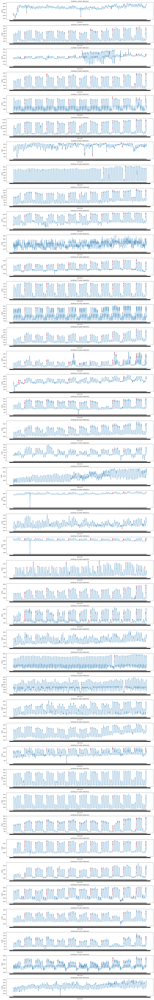

In [ ]:
plot_mark_outlier(train, 24, 'median')

In [ ]:
# 건물별 이상치 탐지 (method = median)
for num in range(1,61):
    print(f'건물 {num}')
    if bool(filter_outlier(train, num, 24, 'median')): 
        for key, value in filter_outlier(train, num, 24, 'median').items():
            print(f'이상치로 의심되는 date_time 및 전력 사용량 : {key}, {value}')
    else:
        print('이상치 의심 케이스 없음')
        
    print('=' * 100)

건물 1
이상치로 의심되는 date_time 및 전력 사용량 : 2020-06-03 14, [8458.992]
이상치로 의심되는 date_time 및 전력 사용량 : 2020-06-09 12, [8171.928]
이상치로 의심되는 date_time 및 전력 사용량 : 2020-06-22 10, [8670.888]
이상치로 의심되는 date_time 및 전력 사용량 : 2020-07-14 01, [7923.744]
이상치로 의심되는 date_time 및 전력 사용량 : 2020-08-02 06, [8518.608]
이상치로 의심되는 date_time 및 전력 사용량 : 2020-08-02 08, [8481.024]
이상치로 의심되는 date_time 및 전력 사용량 : 2020-08-02 09, [8452.512]
이상치로 의심되는 date_time 및 전력 사용량 : 2020-08-10 09, [8681.256]
이상치로 의심되는 date_time 및 전력 사용량 : 2020-08-10 11, [8734.392]
건물 2
이상치로 의심되는 date_time 및 전력 사용량 : 2020-06-08 07, [1306.368]
이상치로 의심되는 date_time 및 전력 사용량 : 2020-06-08 08, [1495.26]
이상치로 의심되는 date_time 및 전력 사용량 : 2020-06-08 09, [1614.168]
이상치로 의심되는 date_time 및 전력 사용량 : 2020-06-08 10, [1730.16]
이상치로 의심되는 date_time 및 전력 사용량 : 2020-06-15 08, [1585.98]
이상치로 의심되는 date_time 및 전력 사용량 : 2020-06-15 09, [1724.652]
이상치로 의심되는 date_time 및 전력 사용량 : 2020-06-15 10, [1828.008]
이상치로 의심되는 date_time 및 전력 사용량 : 2020-06-22 07, [1294.704]
이상치로 의심되는 date_time 및 전력

 **rolling mean 또는 rolling median을 통한 이상치 탐지의 한계** :  이 방법으로 이상치를 적절하게 탐지하는 데 한계가 있었습니다. 일단 이상치가 rolling mean이나 rolling median 자체에 영향을 미쳐 제대로 된 기준치를 제공하지 못하는 경우가 있었습니다. 또한, 계절성과 추세가 있는 경우에도 이 방법은 이상치를 정확하게 탐지하지 못하였습니다. 어떤 건물에서는 실제로 이상치가 아닌 값이 이상치로 탐지되기도 하고, 반대로 이상치임에도 불구하고 탐지되지 않는 경우도 발생했습니다. 

## K Means Clustering을 통한 이상치 탐지

In [ ]:
# K Means Clustering을 사용하여 이상치 탐지 
from sklearn.cluster import KMeans

def filter_outlier_kmeans(df:pd.DataFrame, outlier_frac:float, num:int)->dict:
    df_num = df.loc[df['num'] == num]
    y = np.array(df_num['usage']).reshape(df_num['usage'].shape[0], 1)
    km = KMeans(n_clusters=1).fit(y)

    center = km.cluster_centers_
    distance = np.sqrt((y-center)**2)
    num_of_outliers = int(outlier_frac*len(distance)) 

    distance_df = pd.DataFrame(distance, index=df_num.index, columns=['distance'])
    threshold = distance_df['distance'].sort_values(ascending=False)[:num_of_outliers].min()

    df_num = pd.concat([df_num, distance_df], axis = 1)
    outlier_cand_df = df_num.loc[df_num['distance'] >= threshold]

    outlier_cand = {}
    for date_time in outlier_cand_df['date_time']:
        outlier_cand[date_time] = outlier_cand_df.loc[outlier_cand_df['date_time'] == date_time]['usage'].values
        
    return outlier_cand

In [ ]:
# 건물별 이상치를 시각화하는 함수 (kmeans clustering 사용)
def plot_mark_outlier_kmeans(df:pd.DataFrame, outlier_frac:float, num_list:list):
    fig = plt.figure(figsize = (20, 3*60))
    i = 0
    
    for num in num_list:
        df_num = df.loc[df['num'] == num]
        y = np.array(df_num['usage']).reshape(df_num['usage'].shape[0], 1)
        km = KMeans(n_clusters=1).fit(y)

        center = km.cluster_centers_
        distance = np.sqrt((y - center)**2)
        outliers_fraction = outlier_frac
        num_of_outliers = int(outliers_fraction*len(distance))

        distance_df = pd.DataFrame(distance, index=df_num.index, columns=['distance'])
        threshold = distance_df['distance'].sort_values(ascending=False)[:num_of_outliers].min()

        df_num = pd.concat([df_num, distance_df], axis = 1)
        outlier_cand_df = df_num.loc[df_num['distance'] >= threshold]
    
        ax = fig.add_subplot(60, 1, i+1)
        ax.set(title=f'building {num} outlier detection')
            
        plt.plot(df_num['date_time'], df_num['usage'])
        plt.scatter(outlier_cand_df['date_time'], outlier_cand_df['usage'], color='red')
        i+=1
    
    plt.tight_layout()
    plt.show()

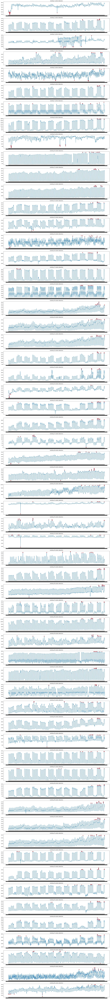

In [ ]:
plot_mark_outlier_kmeans(train, 0.01, range(1, 61))

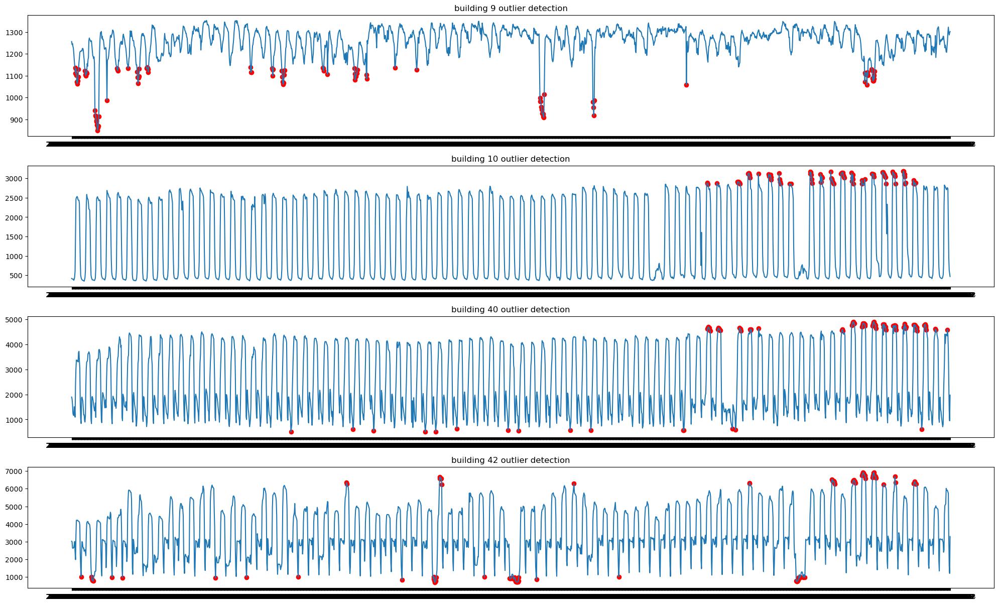

In [ ]:
# 이상치를 제대로 탐지하지 못하는 건물 9, 10, 40, 42에 대해 outlier fraction을 0.05로 높여서 재탐지한 결과를 시각화 
plot_mark_outlier_kmeans(train, 0.05, [9, 10, 40, 42])

In [ ]:
# 건물별 이상치 탐지 (kmeans clustering 사용)
for num in range(1,61):
    print(f'건물 {num}')
    for key, value in filter_outlier_kmeans(train, 0.01, num).items():
        print(f'이상치로 의심되는 date_time 및 전력 사용량 : {key}, {value}')
    print('=' * 100)

건물 1
이상치로 의심되는 date_time 및 전력 사용량 : 2020-06-01 06, [7978.176]
이상치로 의심되는 date_time 및 전력 사용량 : 2020-06-01 21, [7974.936]
이상치로 의심되는 date_time 및 전력 사용량 : 2020-06-01 22, [7972.992]
이상치로 의심되는 date_time 및 전력 사용량 : 2020-06-01 23, [7945.128]
이상치로 의심되는 date_time 및 전력 사용량 : 2020-06-02 00, [7920.504]
이상치로 의심되는 date_time 및 전력 사용량 : 2020-06-02 01, [7890.048]
이상치로 의심되는 date_time 및 전력 사용량 : 2020-06-02 02, [7868.016]
이상치로 의심되는 date_time 및 전력 사용량 : 2020-06-02 03, [7847.28]
이상치로 의심되는 date_time 및 전력 사용량 : 2020-06-02 04, [7799.328]
이상치로 의심되는 date_time 및 전력 사용량 : 2020-06-02 05, [7801.92]
이상치로 의심되는 date_time 및 전력 사용량 : 2020-06-02 06, [7784.424]
이상치로 의심되는 date_time 및 전력 사용량 : 2020-06-02 07, [7836.912]
이상치로 의심되는 date_time 및 전력 사용량 : 2020-06-02 08, [7873.2]
이상치로 의심되는 date_time 및 전력 사용량 : 2020-06-02 09, [7914.024]
이상치로 의심되는 date_time 및 전력 사용량 : 2020-06-02 10, [7973.64]
이상치로 의심되는 date_time 및 전력 사용량 : 2020-06-02 11, [7989.84]
이상치로 의심되는 date_time 및 전력 사용량 : 2020-06-02 12, [7935.408]
이상치로 의심되는 date_time 및 전력 사용량 : 2

**K Means Clustering을 통한 이상치 탐지의 한계** : 이 방법은 데이터 전체의 평균을 기준으로 이상치를 탐지하는 것과 유사하다는 단점이 있습니다. 이에 대한 보완으로 n_clusters를 늘려서 각 데이터 포인트와 모든 클러스터 중심 간의 거리를 계산한 후, 각 데이터 포인트와 가장 가까운 클러스터 중심과의 거리를 구하여 이 거리를 기준으로 outlier_frac 비율의 이상치를 탐지하는 아이디어도 떠올려 봤는데 이렇게 하면 여러 클러스터에 걸쳐있는 데이터를 기준으로 이상치를 탐지할 수 있지만, 건물별로 적절한 n_clusters 수를 선택하기가 어려웠습니다.
결과적으로 K Means Clustering을 통한 이상치 탐지도 이상치를 적절하게 탐지하기에 한계가 있었습니다. 계절성과 추세가 있는 경우에 이상치를 정확하게 탐지하기가 어렵고, n_clusters와 outlier_frac 변수를 2개 사용하므로 건물 60개 각각에 대해 이 변수들의 적절한 값을 찾기 어렵다는 문제가 있었습니다.

## 잔차 분포를 통한 이상치 탐지 

In [ ]:
# 건물별 시계열 분해를 통하여 도출한 잔차에 대해 z-test 진행

from statsmodels.tsa.seasonal import seasonal_decompose
from statsmodels.stats.weightstats import ztest


def resid_ztest(df:pd.DataFrame, num:int):
    df_num = df.loc[df['num'] == num]

    decomposition = seasonal_decompose(df_num['usage'], model='additive', two_sided=True, period=24, extrapolate_trend='freq')
    r = decomposition.resid.values
    tst, p = ztest(r)
    print(f'건물 {num}의 tstat : {tst}, p-value : {p}')
    
    
for num in range(1, 61):
    resid_ztest(train, num) # 모든 건물의 p-value가 0.05 이상이므로 잔차가 정규분포를 이루고 있음.

건물 1의 tstat : 0.46667044002538316, p-value : 0.640735681714476
건물 2의 tstat : -0.33040756060092796, p-value : 0.7410920294938654
건물 3의 tstat : -0.00293498932010291, p-value : 0.9976582206974469
건물 4의 tstat : 0.08435576593877077, p-value : 0.9327735755466064
건물 5의 tstat : -0.3911542596236231, p-value : 0.695683215725262
건물 6의 tstat : -0.2837790550986461, p-value : 0.7765797065610411
건물 7의 tstat : -0.5451366924798451, p-value : 0.5856595084138607
건물 8의 tstat : -0.3292593314653146, p-value : 0.7419596806150821
건물 9의 tstat : 0.20357558876373252, p-value : 0.8386851709967325
건물 10의 tstat : -0.014231176483039135, p-value : 0.9886455472661251
건물 11의 tstat : 0.10988725285067828, p-value : 0.9124987920692104
건물 12의 tstat : 0.15625839693097177, p-value : 0.8758293478934671
건물 13의 tstat : -0.35400465959907346, p-value : 0.7233353912197518
건물 14의 tstat : -0.36740695038115184, p-value : 0.7133154879262308
건물 15의 tstat : -0.1263897903648844, p-value : 0.8994233834525576
건물 16의 tstat : -0.346910386921

In [ ]:
# 시계열 분해를 통해 잔차 평균 +- 3* 잔차 표준편차를 기준으로 이상치 탐지하는 함수 
from statsmodels.tsa.seasonal import seasonal_decompose
from statsmodels.stats.weightstats import ztest

def filter_outlier_sd(df:pd.DataFrame, num:int)->tuple:
    df_num = df.loc[df['num'] == num]

    decomposition = seasonal_decompose(df_num['usage'], model='additive', two_sided=True, period=24, extrapolate_trend='freq')
    r = decomposition.resid.values
    tst, p = ztest(r)
    
    if p >= 0.05:    
        resid_mean, resid_std = decomposition.resid.mean(), decomposition.resid.std()
        num_outliers = len(decomposition.resid[(decomposition.resid > resid_mean + 3*resid_std)|(decomposition.resid < resid_mean - 3*resid_std)])
        dt_outliers = df_num['date_time'][decomposition.resid[(decomposition.resid > resid_mean + 3*resid_std)|(decomposition.resid < resid_mean - 3*resid_std)].index]
    
    return (num_outliers, dt_outliers)

In [ ]:
# 시계열 분해의 잔차를 통해 건물별 이상치 탐지하여 시각화하는 함수 
def plot_mark_outlier(df:pd.DataFrame):
    detect_list = []
    
    for num in range(1, 61):
        num_outliers, _ = filter_outlier_sd(train, num)
        if num_outliers != 0:
                detect_list.append(num)

    fig = plt.figure(figsize = (20, 3*len(detect_list)))

    for i, num in enumerate(detect_list):
        ax = fig.add_subplot(len(detect_list), 1, i+1)
        ax.set(title=f'building {num} outlier detection')

        df_num = df.loc[df['num'] == num]
        sns.lineplot(x=df_num['date_time'], y=df_num['usage'])

        _, dt_outliers = filter_outlier_sd(train, num) 
        marker = df.iloc[dt_outliers.index]
        sns.scatterplot(x=marker['date_time'], y=marker['usage'], color='red', zorder=7)
 
    plt.tight_layout()
    plt.show()

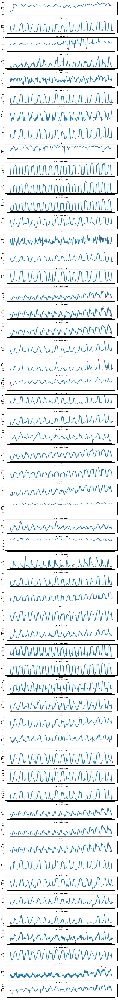

In [ ]:
plot_mark_outlier(train)

In [ ]:
# 시계열 분해를 통해 잔차 평균 +- 3* 잔차 표준편차를 기준으로 건물별 아웃라이어 탐지 
for num in range(1, 61):
    num_outliers, dt_outliers = filter_outlier_sd(train, num)
    print(f'건물 {num} 탐지된 아웃라이어 개수 : {num_outliers}')
    print(f'건물 {num} 탐지된 아웃라이어 날짜 : \n {dt_outliers}')
    print('=' * 80)

건물 1 탐지된 아웃라이어 개수 : 17
건물 1 탐지된 아웃라이어 날짜 : 
 0       2020-06-01 00
62      2020-06-03 14
63      2020-06-03 15
64      2020-06-03 16
65      2020-06-03 17
66      2020-06-03 18
70      2020-06-03 22
71      2020-06-03 23
72      2020-06-04 00
73      2020-06-04 01
204     2020-06-09 12
1033    2020-07-14 01
1034    2020-07-14 02
1161    2020-07-19 09
1497    2020-08-02 09
1505    2020-08-02 17
1983    2020-08-22 15
Name: date_time, dtype: object
건물 2 탐지된 아웃라이어 개수 : 2
건물 2 탐지된 아웃라이어 날짜 : 
 4078    2020-08-24 22
4079    2020-08-24 23
Name: date_time, dtype: object
건물 3 탐지된 아웃라이어 개수 : 32
건물 3 탐지된 아웃라이어 날짜 : 
 5174    2020-07-16 14
5196    2020-07-17 12
5222    2020-07-18 14
5244    2020-07-19 12
5246    2020-07-19 14
5267    2020-07-20 11
5268    2020-07-20 12
5269    2020-07-20 13
5270    2020-07-20 14
5291    2020-07-21 11
5292    2020-07-21 12
5293    2020-07-21 13
5294    2020-07-21 14
5316    2020-07-22 12
5364    2020-07-24 12
5412    2020-07-26 12
5435    2020-07-27 11
5436    2020

**잔차 분포를 통한 이상치 탐지 채택** : 잔차 평균 +- 3* 잔차 표준편차를 기준으로 이상치를 탐지한 결과, 앞에서 사용한 rolling mean 또는 rolling median을 통한 이상치 탐지, K Means Clustering을 통한 이상치 탐지 방법들보다 더 정확히 이상치를 탐지할 수 있었습니다. 따라서 이 방법을 기반으로 이상치를 탐지하여 처리하였습니다. 